# Uber Business Analytics

Problem Statement - Provide Business Insights by identifying bottleneck areas for the city of Los Angeles by usint Uber movement data.

# Importing all the necessary libraries

In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from libpysal import weights
import geopandas as gp
import reverse_geocoder as rg
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv('los_angeles-censustracts-2020-1-All-HourlyAggregate.csv')#Reading the uber movement data

# Subset the dataset to analyze the data at two different timestamps: 23:00 PM and 10:00 AM

In [3]:
df_night = df[df['hod']==23]
df_day = df[df['hod']==10]

# Reading json file having the coordinates of polygon using geopandas. Each polygon represents Los Angeles County. 

In [4]:
geo_df = gp.read_file('los_angeles_censustracts.json')
geo_df.set_crs(epsg=3498, allow_override=True)

,MOVEMENT_ID,TRACT,DISPLAY_NAME,geometry
0,1,480302,Census Tract 480302,"POLYGON ((-118.11683 34.10722, -118.11631 34.1..."
1,2,480303,Census Tract 480303,"POLYGON ((-118.13467 34.09877, -118.13464 34.0..."
2,3,480304,Census Tract 480304,"POLYGON ((-118.13453 34.09157, -118.13462 34.0..."
3,4,480400,Census Tract 480400,"POLYGON ((-118.12276 34.10447, -118.12386 34.1..."
4,5,480500,Census Tract 480500,"POLYGON ((-118.14178 34.09877, -118.14178 34.0..."
...,...,...,...,...
2711,2712,087902,Census Tract 087902,"POLYGON ((-117.98846 33.79567, -117.98806 33.7..."
2712,2713,110006,Census Tract 110006,"POLYGON ((-118.07218 33.79518, -118.07218 33.7..."
2713,2714,110007,Census Tract 110007,"POLYGON ((-118.08168 33.79407, -118.08155 33.7..."
2714,2715,110008,Census Tract 110008,"POLYGON ((-118.07618 33.78551, -118.07618 33.7..."


# Calculating the centroids of each centroid and converting the graph to networkx graph for further easy manipulation.

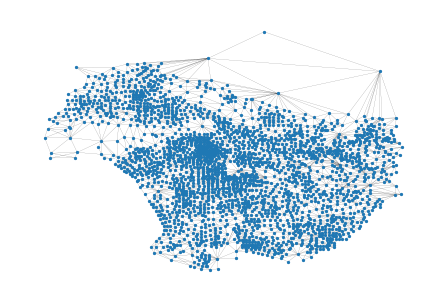

In [5]:
centroids = np.column_stack((geo_df.centroid.x, geo_df.centroid.y))
queen = weights.Queen.from_dataframe(geo_df)
graph = queen.to_networkx()
positions = dict(zip(graph.nodes, centroids))
nx.draw(graph, positions, node_size=5, width=0.1)


# Creating two separate dataframe for day and night, and using 300,000 rows for data analysis.

In [6]:
data_night=zip(df_night['sourceid'],df_night['dstid'])
data_night=list(data_night)
data_night=data_night[0:300000]

data_day=zip(df_day['sourceid'],df_day['dstid'])
data_day=list(data_day)
data_day=data_day[0:300000]

# Remove the edges from the networkx graph and divide it into two halves, with 'x' representing night and 'y' representing day. Convert the undirected graph to a directed graph, with each directed arrow indicating a ride.

In [7]:
x = nx.classes.function.create_empty_copy(graph)
x = x.to_directed()

y = nx.classes.function.create_empty_copy(graph)
y = y.to_directed()

# Add edges to both the graphs

In [8]:
x.add_edges_from(data_night)
y.add_edges_from(data_day)

# First, analysing the night dataset.
# Set the mean travel as edge attribute for calculating the centrality and finding bottleneck areas.

In [9]:
data_dict={}
for i in range(0,300000):
    data_dict[data_night[i]] = df_night['mean_travel_time'].iloc[i]


    
nx.set_edge_attributes(x, values=data_dict, name="Mean Time")

# Calculate the three centrality measures and pagerank

In [10]:
deg=nx.degree_centrality(x)
bet=nx.betweenness_centrality(x)
close=nx.closeness_centrality(x)
pr = nx.pagerank(x, alpha=0.85)

# Visualizing the degree centrality for the night graph and identifying the most important areas.

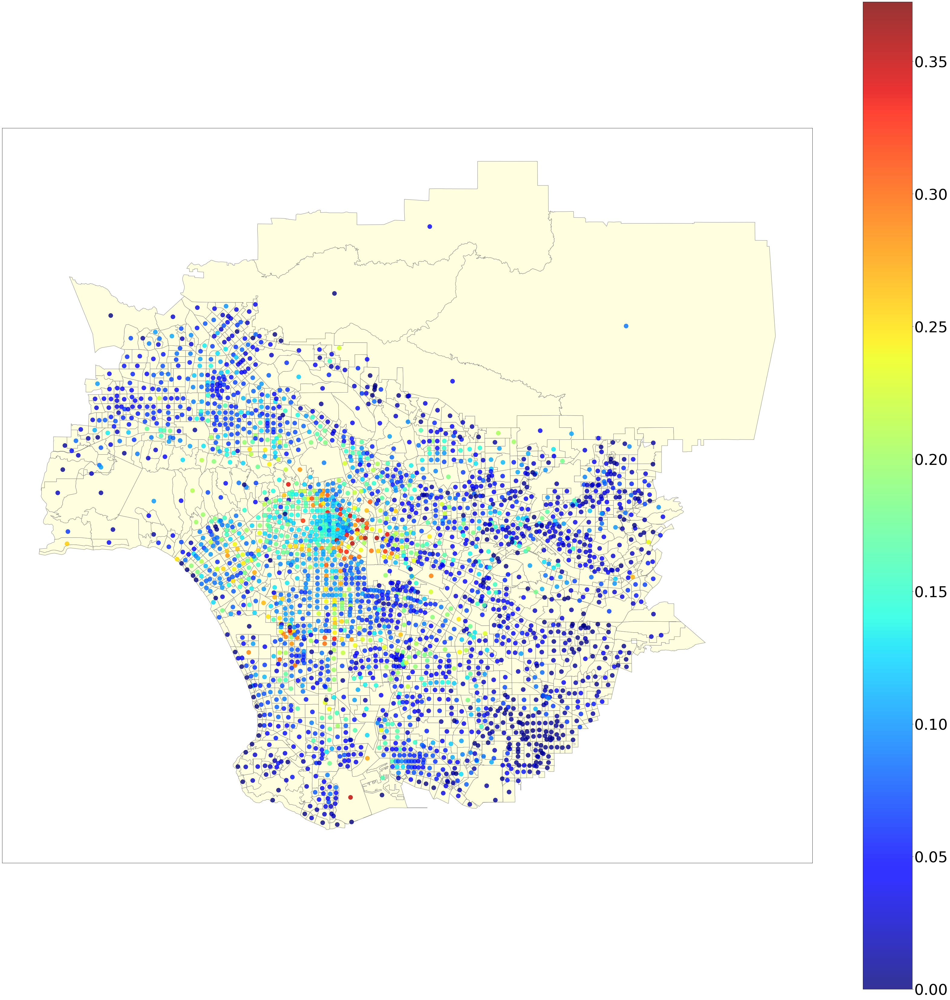

In [46]:
colors = [deg[i] for i in x.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=x.nodes(), node_color=colors, 
                            node_size=200, cmap=plt.cm.jet, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("Degree.png", dpi=100)
plt.show()


In [47]:
geo_df["x"] = geo_df.centroid.map(lambda p: p.x)
geo_df["y"] = geo_df.centroid.map(lambda p: p.y)

In [56]:
a = [k for k,v in deg.items() if v >= 0.35]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.07808', 'lon': '-118.26066', 'name': 'Echo Park', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.73585', 'lon': '-118.29229', 'name': 'San Pedro', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]


# Visualizing the betweenness centrality for the night graph and identifying the most important areas.

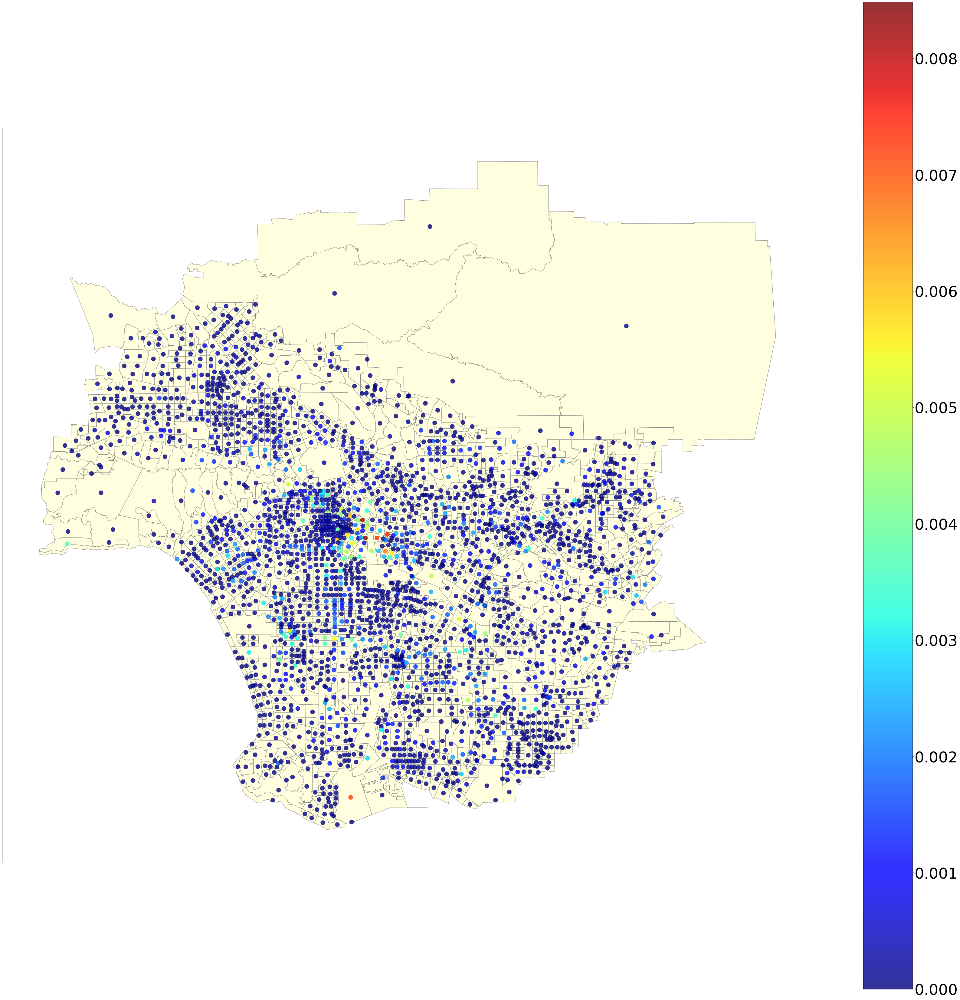

In [58]:
colors = [bet[i] for i in x.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=x.nodes(), node_color=colors, 
                            node_size=200, cmap=plt.cm.jet, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("Betweeness.png", dpi=100)
plt.show()

In [59]:
a = [k for k,v in bet.items() if v >= 0.007]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.0339', 'lon': '-118.20535', 'name': 'Boyle Heights', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.73585', 'lon': '-118.29229', 'name': 'San Pedro', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]


# Visualizing the closeness centrality for the night graph and identifying the most important areas.

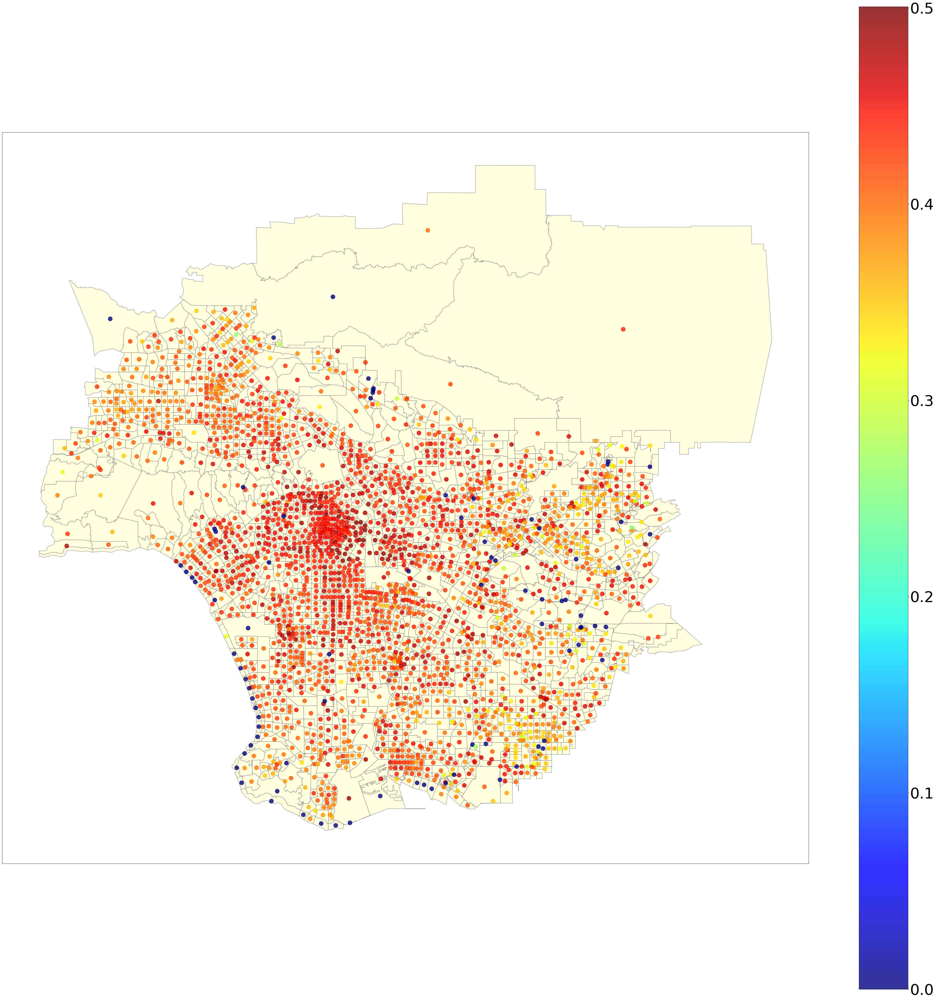

In [69]:
colors = [close[i] for i in x.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=x.nodes(),cmap=plt.cm.jet, node_color=colors, 
                            node_size=200, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("Closeness.png", dpi=100)
plt.show()

In [77]:
a = [k for k,v in close.items() if v >= 0.495]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '34.07808', 'lon': '-118.26066', 'name': 'Echo Park', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.0339', 'lon': '-118.20535', 'name': 'Boyle Heights', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]


# Visualizing the pagerank algorithm output for the night graph and identifying the most important areas.

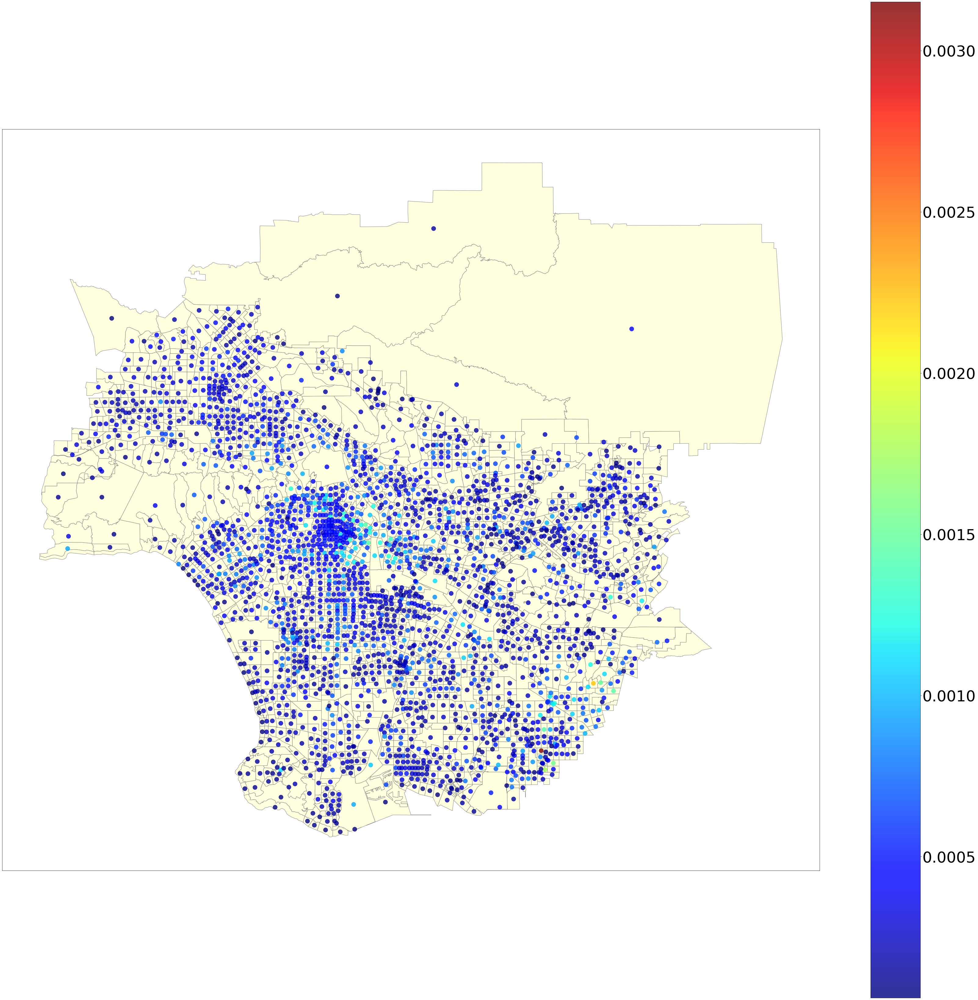

In [78]:
colors = [pr[i] for i in x.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=x.nodes(),cmap=plt.cm.jet, node_color=colors, 
                            node_size=200, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("PageRank.png", dpi=100)
plt.show()

In [94]:
a = [k for k,v in pr.items() if v >= 0.00145]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '33.87029', 'lon': '-117.92534', 'name': 'Fullerton', 'admin1': 'California', 'admin2': 'Orange County', 'cc': 'US'}]
[{'lat': '33.87029', 'lon': '-117.92534', 'name': 'Fullerton', 'admin1': 'California', 'admin2': 'Orange County', 'cc': 'US'}]
[{'lat': '33.80252', 'lon': '-117.99312', 'name': 'Stanton', 'admin1': 'California', 'admin2': 'Orange County', 'cc': 'US'}]
[{'lat': '33.80252', 'lon': '-117.99312', 'name': 'Stanton', 'admin1': 'California', 'admin2': 'Orange County', 'cc': 'US'}]
[{'lat': '33.80252', 'lon': '-117.99312', 'name': 'Stanton', 'admin1': 'California', 'admin2': 'Orange County', 'cc': 'US'}]


# Follwing the above same procudure for the day graph.

In [95]:
data_dict={}
for i in range(0,300000):
    data_dict[data_day[i]] = df_day['mean_travel_time'].iloc[i]
data_dict

nx.set_edge_attributes(y, values=data_dict, name="Mean Time")

In [97]:
deg=nx.degree_centrality(y)
bet=nx.betweenness_centrality(y)
close=nx.closeness_centrality(y)
pr = nx.pagerank(y, alpha=0.85)

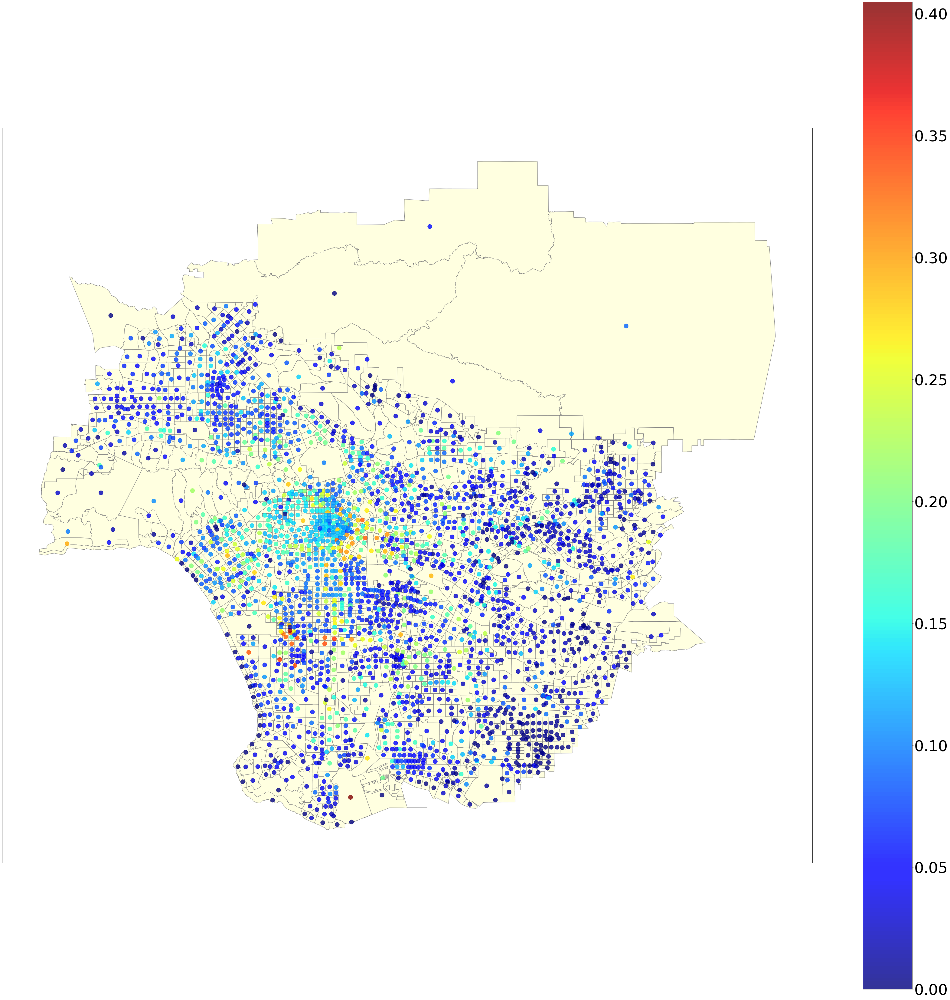

In [106]:
colors = [deg[i] for i in y.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=y.nodes(),cmap=plt.cm.jet, node_color=colors, 
                            node_size=200, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("DegreeDay.png", dpi=100)
plt.show()

In [107]:
a = [k for k,v in deg.items() if v >= 0.35]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '33.91613', 'lon': '-118.36952', 'name': 'Del Aire', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.92335', 'lon': '-118.30341', 'name': 'West Athens', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.73585', 'lon': '-118.29229', 'name': 'San Pedro', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.93807', 'lon': '-118.35258', 'name': 'Lennox', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]


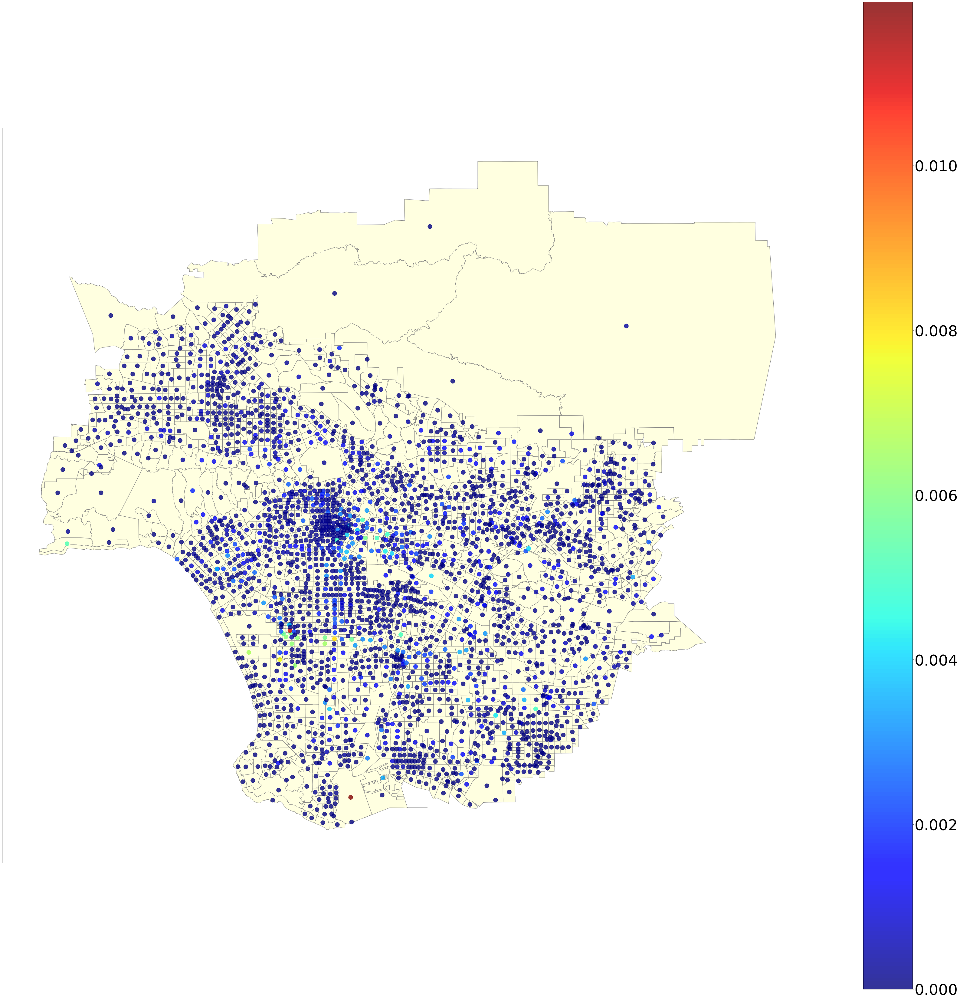

In [108]:
colors = [bet[i] for i in y.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=y.nodes(),cmap=plt.cm.jet, node_color=colors, 
                            node_size=200, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("BetweenessDay.png", dpi=100)
plt.show()

In [109]:
a = [k for k,v in bet.items() if v >= 0.01]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '33.73585', 'lon': '-118.29229', 'name': 'San Pedro', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.93807', 'lon': '-118.35258', 'name': 'Lennox', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]


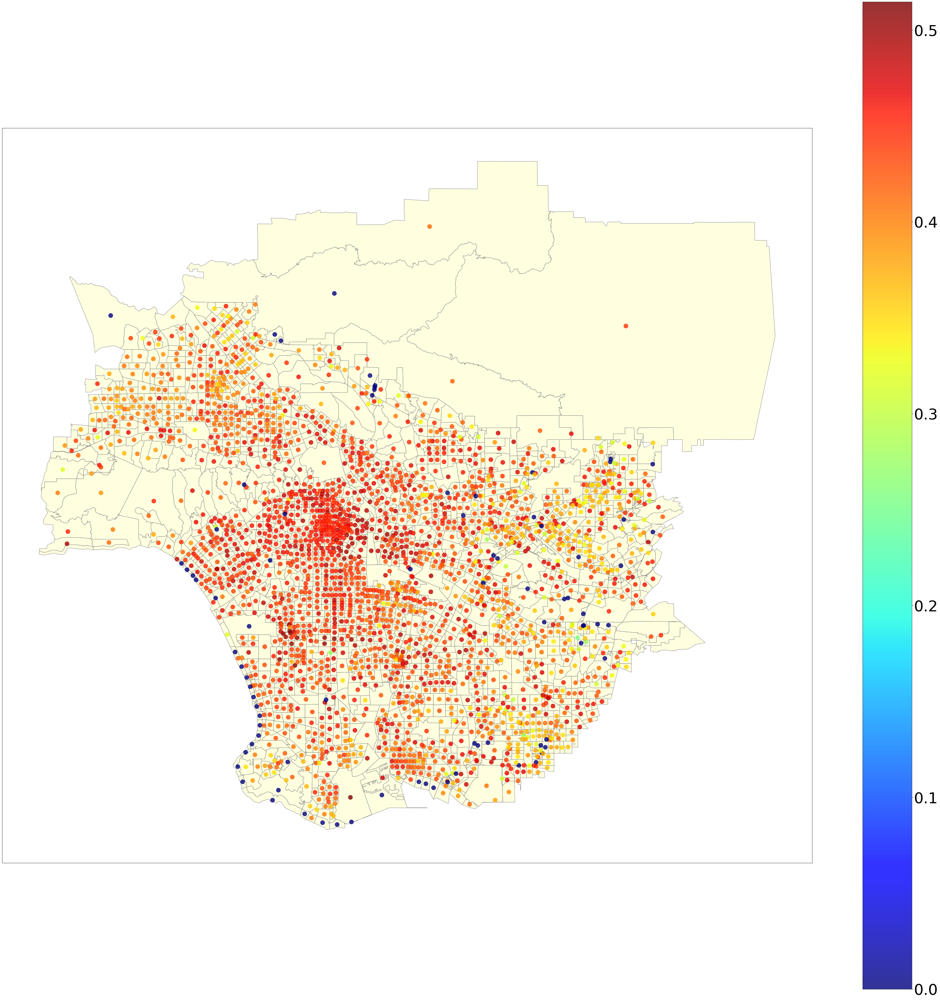

In [110]:
colors = [close[i] for i in y.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=y.nodes(),cmap=plt.cm.jet, node_color=colors, 
                            node_size=200, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("ClosenessDay.png", dpi=100)
plt.show()

In [130]:
a = [k for k,v in close.items() if v >= 0.5]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '33.93807', 'lon': '-118.35258', 'name': 'Lennox', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.93807', 'lon': '-118.35258', 'name': 'Lennox', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.93807', 'lon': '-118.35258', 'name': 'Lennox', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.93807', 'lon': '-118.35258', 'name': 'Lennox', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.9164', 'lon': '-118.35257', 'name': 'Hawthorne', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.91613', 'lon': '-118.36952', 'name': 'Del Aire', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '33.88724', 'lon': '-118.35257', 'name': 'Lawndale', 'admin1': 'California', 'admin2': 'Los Angeles County', 'cc': 'US'}]
[{'lat': '34.05223', 'lon': '-118.24368', 'name': 'Los Angeles', 'admin1': 'California', 'a

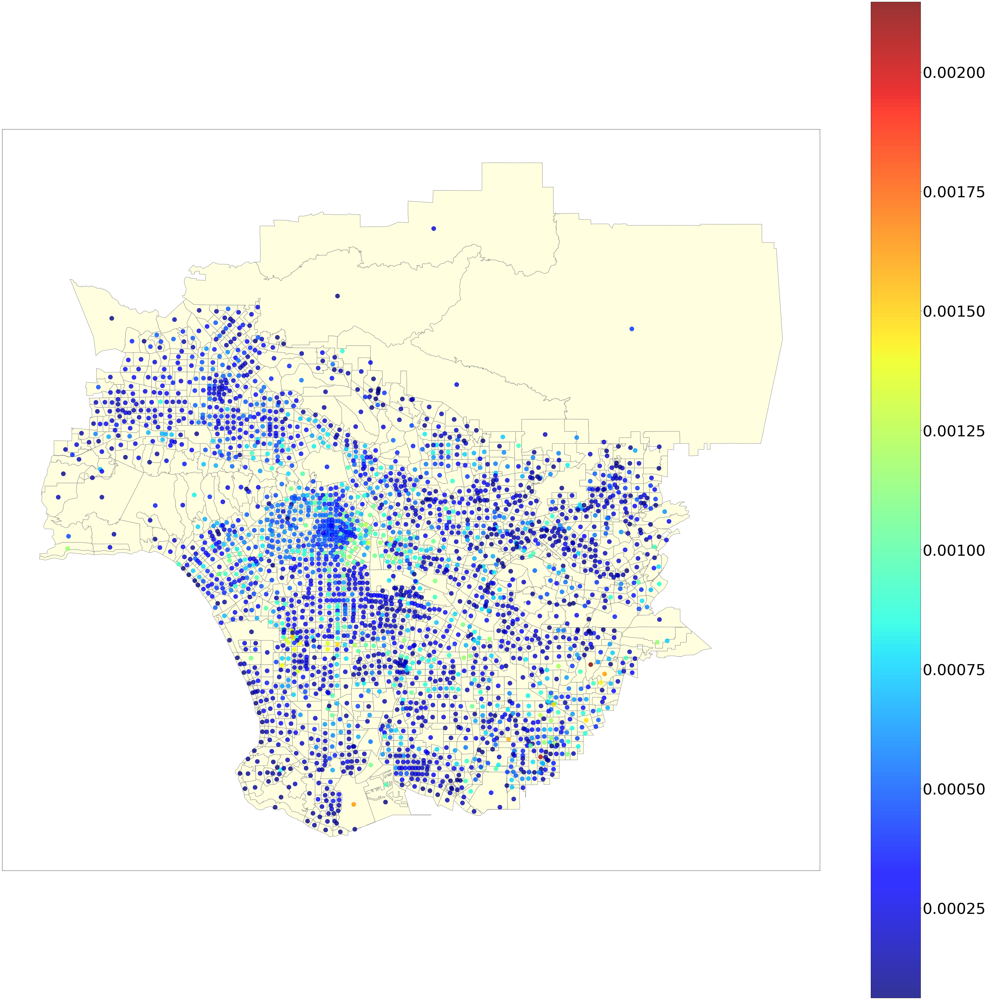

In [131]:
colors = [pr[i] for i in y.nodes()]
#plt.figure(figsize=(180,180))
ax = geo_df.plot(linewidth=1, edgecolor="grey", facecolor="lightyellow", figsize=(60,60))
nc = nx.draw_networkx_nodes(x, positions, ax=ax, nodelist=y.nodes(),cmap=plt.cm.jet, node_color=colors, 
                            node_size=200, alpha=0.8)
#ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_yticklabels(colors, fontsize=250)

cc = plt.colorbar(nc)
cc.ax.tick_params(labelsize=50)

#plt.axis('off')
plt.savefig("PageRankDay.png", dpi=100)
plt.show()

In [132]:
a = [k for k,v in pr.items() if v >= 0.002]

for i in a:
    print(rg.search((geo_df.loc[[i], 'y'][i], geo_df.loc[[i],'x'][i])))

[{'lat': '33.91668', 'lon': '-117.90006', 'name': 'Brea', 'admin1': 'California', 'admin2': 'Orange County', 'cc': 'US'}]
[{'lat': '33.80252', 'lon': '-117.99312', 'name': 'Stanton', 'admin1': 'California', 'admin2': 'Orange County', 'cc': 'US'}]


# Conclusions